# Import Library

In [1]:
import numpy as np
import pandas as pd 
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import random
import os
#print(os.listdir("../input"))


# Define Constants

In [2]:
FAST_RUN = False
IMAGE_WIDTH= 128
IMAGE_HEIGHT= 128
IMAGE_SIZE=(IMAGE_WIDTH, IMAGE_HEIGHT)
IMAGE_CHANNELS=3

# Prepare Traning Data

In [3]:
'''filenames = os.listdir("../input/train/train")
categories = []
for filename in filenames:
    category = filename.split('.')[0]
    if category == 'dog':
        categories.append(1)
    else:
        categories.append(0)

df = pd.DataFrame({
    'filename': filenames,
    'category': categories
})'''

'filenames = os.listdir("../input/train/train")\ncategories = []\nfor filename in filenames:\n    category = filename.split(\'.\')[0]\n    if category == \'dog\':\n        categories.append(1)\n    else:\n        categories.append(0)\n\ndf = pd.DataFrame({\n    \'filename\': filenames,\n    \'category\': categories\n})'

In [3]:
df = pd.read_csv('all_data.csv')

In [4]:
df

,filename,class
0,DJI_20211222112117_0035_1024_4096.JPG,cement
1,DJI_20211222112117_0035_1024_4608.JPG,cement
2,DJI_20211222112117_0035_1024_5120.JPG,cement
3,DJI_20211222112117_0035_1536_3584.JPG,cement
4,DJI_20211222112117_0035_1536_4096.JPG,cement
...,...,...
1206,DJI_20220120134557_0318_512_5632.JPG,nocement
1207,DJI_20220120134557_0318_512_6144.JPG,nocement
1208,DJI_20220120134557_0318_512_6656.JPG,nocement
1209,DJI_20220120134557_0318_512_7168.JPG,nocement


In [5]:
df.head()

,filename,class
0,DJI_20211222112117_0035_1024_4096.JPG,cement
1,DJI_20211222112117_0035_1024_4608.JPG,cement
2,DJI_20211222112117_0035_1024_5120.JPG,cement
3,DJI_20211222112117_0035_1536_3584.JPG,cement
4,DJI_20211222112117_0035_1536_4096.JPG,cement


In [6]:
df.tail()

,filename,class
1206,DJI_20220120134557_0318_512_5632.JPG,nocement
1207,DJI_20220120134557_0318_512_6144.JPG,nocement
1208,DJI_20220120134557_0318_512_6656.JPG,nocement
1209,DJI_20220120134557_0318_512_7168.JPG,nocement
1210,DJI_20220120134557_0318_512_7680.JPG,nocement


### See Total In count

<AxesSubplot:>

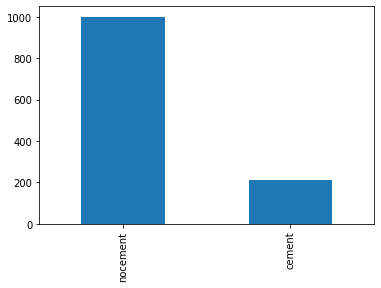

In [7]:
df['class'].value_counts().plot.bar()

# See sample image

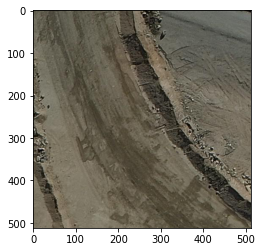

In [12]:
sample = random.choice(df['filename'])
image = load_img("C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\all_data\\"+sample)

plt.imshow(image)

* **Input Layer**: It represent input image data. It will reshape image into single diminsion array. Example your image is 64x64 = 4096, it will convert to (4096,1) array.
* **Conv Layer**: This layer will extract features from image.
* **Pooling Layer**: This layerreduce the spatial volume of input image after convolution.
* **Fully Connected Layer**: It connect the network from a layer to another layer
* **Output Layer**: It is the predicted values layer. 

In [13]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dropout, Flatten, Dense, Activation, BatchNormalization

In [14]:
import tensorflow as tf
optimizer = tf.keras.optimizers.Adam(lr = 0.01)

In [15]:


model = Sequential()

model.add(Conv2D(32, (3, 3), activation='relu', input_shape=(IMAGE_WIDTH, IMAGE_HEIGHT, IMAGE_CHANNELS)))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())
model.add(Dense(512, activation='relu'))
model.add(BatchNormalization())
model.add(Dropout(0.5))
model.add(Dense(2, activation='softmax'))
#optimizer = tensorflow.keras.optimizer.adam(lr = 0.01)
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 126, 126, 32)      896       
_________________________________________________________________
batch_normalization (BatchNo (None, 126, 126, 32)      128       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 63, 63, 32)        0         
_________________________________________________________________
dropout (Dropout)            (None, 63, 63, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 61, 61, 64)        18496     
_________________________________________________________________
batch_normalization_1 (Batch (None, 61, 61, 64)        256       
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 30, 30, 64)        0

# Callbacks

In [16]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

**Early Stop**

To prevent over fitting we will stop the learning after 10 epochs and val_loss value not decreased

In [17]:
earlystop = EarlyStopping(patience=8)

**Learning Rate Reduction**

We will reduce the learning rate when then accuracy not increase for 2 steps

In [18]:
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', 
                                            patience=2, 
                                            verbose=1, 
                                            factor=0.5, 
                                            min_lr=0.00001)

In [19]:
callbacks = [earlystop, learning_rate_reduction]

# Prepare data

Because we will use image genaretor `with class_mode="categorical"`. We need to convert column category into string. Then imagenerator will convert it one-hot encoding which is good for our classification. 

So we will convert 1 to dog and 0 to cat

In [18]:
#df["category"] = df["category"].replace({0: 'cat', 1: 'dog'}) 

In [20]:
train_df, validate_df = train_test_split(df, test_size=0.20)
train_df = train_df.reset_index(drop=True)
validate_df = validate_df.reset_index(drop=True)

<AxesSubplot:>

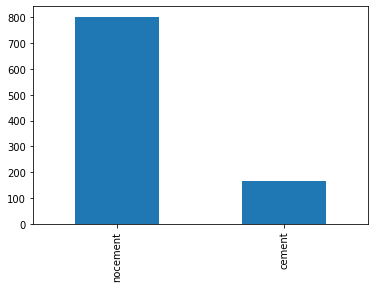

In [21]:
train_df['class'].value_counts().plot.bar()

<AxesSubplot:>

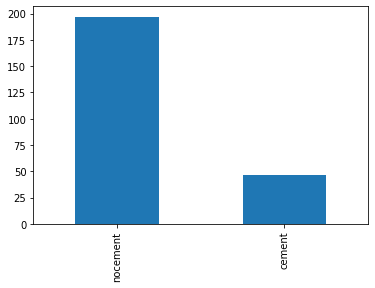

In [22]:
validate_df['class'].value_counts().plot.bar()

In [23]:
total_train = train_df.shape[0]
total_validate = validate_df.shape[0]

In [24]:
total_train

968

In [25]:
total_validate

243

In [26]:
batch_size=2

In [27]:
train_df

,filename,class
0,DJI_20220120134542_0315_1024_4096.JPG,nocement
1,DJI_20220120134531_0313_3584_6656.JPG,nocement
2,DJI_20220120134547_0316_2560_6144.JPG,nocement
3,DJI_20220120134531_0313_2560_0.JPG,nocement
4,DJI_20220120134530_0312_4608_1024.JPG,nocement
...,...,...
963,DJI_20220120134542_0315_2560_2560.JPG,nocement
964,DJI_20220120134531_0313_2560_6656.JPG,nocement
965,DJI_20220120134531_0313_0_2560.JPG,cement
966,DJI_20220120134542_0315_2560_512.JPG,nocement


# Traning Generator

In [32]:
os.listdir("C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\all_data")


['DJI_20211222112117_0035_1024_4096.JPG',
 'DJI_20211222112117_0035_1024_4608.JPG',
 'DJI_20211222112117_0035_1024_5120.JPG',
 'DJI_20211222112117_0035_1536_3584.JPG',
 'DJI_20211222112117_0035_1536_4096.JPG',
 'DJI_20211222112117_0035_1536_4608.JPG',
 'DJI_20211222112117_0035_1536_5120.JPG',
 'DJI_20211222112117_0035_2048_4096.JPG',
 'DJI_20211222112117_0035_2048_4608.JPG',
 'DJI_20211222112117_0035_2048_5120.JPG',
 'DJI_20211222112117_0035_512_4096.JPG',
 'DJI_20211222112117_0035_512_4608.JPG',
 'DJI_20211222112117_0035_512_5120.JPG',
 'DJI_20211222112118_0036_3072_4096.JPG',
 'DJI_20211222112118_0036_3072_4608.JPG',
 'DJI_20211222112118_0036_3072_5120.JPG',
 'DJI_20211222112118_0036_3072_5632.JPG',
 'DJI_20211222112118_0036_3584_4096.JPG',
 'DJI_20211222112118_0036_3584_4608.JPG',
 'DJI_20211222112118_0036_3584_5120.JPG',
 'DJI_20211222112118_0036_3584_5632.JPG',
 'DJI_20211222112118_0036_4096_4096.JPG',
 'DJI_20211222112118_0036_4096_4608.JPG',
 'DJI_20211222112118_0036_4096_5120.J

In [33]:
train_datagen = ImageDataGenerator(
    rotation_range=360,
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    width_shift_range=0.1,
    height_shift_range=0.1
)

train_generator = train_datagen.flow_from_dataframe(
    train_df, 
    "C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\all_data", 
    x_col='filename',
    y_col='class',
    target_size=IMAGE_SIZE,
    class_mode='categorical',
    batch_size=batch_size,
    
)

Found 968 validated image filenames belonging to 2 classes.


### Validation Generator

In [36]:
validation_datagen = ImageDataGenerator(rescale=1./255)
validation_generator = validation_datagen.flow_from_dataframe(
    validate_df, 
    "C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\all_data", 
    x_col='filename',
    y_col='class',
    target_size=IMAGE_SIZE,
    class_mode='categorical',
    batch_size=batch_size
)

Found 243 validated image filenames belonging to 2 classes.


# See how our generator work

In [37]:
example_df = train_df.sample(n=1).reset_index(drop=True)
example_generator = train_datagen.flow_from_dataframe(
    example_df, 
    "C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\all_data", 
    x_col='filename',
    y_col='class',
    target_size=IMAGE_SIZE,
    class_mode='categorical'
)

Found 1 validated image filenames belonging to 1 classes.


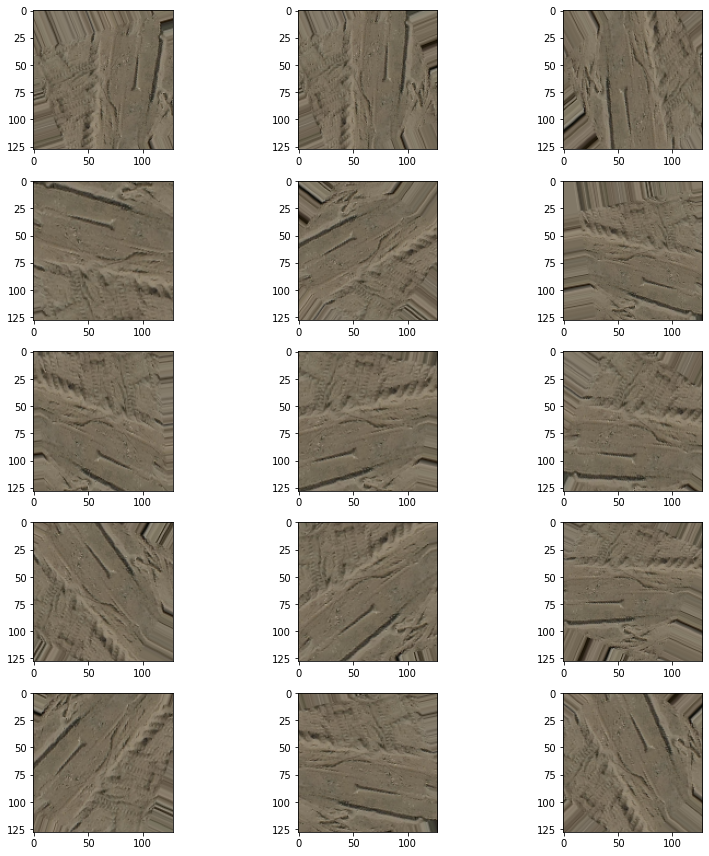

In [38]:
plt.figure(figsize=(12, 12))
for i in range(0, 15):
    plt.subplot(5, 3, i+1)
    for X_batch, Y_batch in example_generator:
        image = X_batch[0]
        plt.imshow(image)
        break
plt.tight_layout()
plt.show()

Seem to be nice 

# Allowing GPU to allocate memory to tf

In [42]:
#!conda activate mk_ml_app

In [41]:
!conda info --envs

# conda environments:
#
base                  *  C:\Users\Z004ET6Z\Anaconda3
Permeability_Correlation     C:\Users\Z004ET6Z\Anaconda3\envs\Permeability_Correlation
UI                       C:\Users\Z004ET6Z\Anaconda3\envs\UI
battery                  C:\Users\Z004ET6Z\Anaconda3\envs\battery
healthcare               C:\Users\Z004ET6Z\Anaconda3\envs\healthcare
oneNeuron                C:\Users\Z004ET6Z\Anaconda3\envs\oneNeuron
opencv                   C:\Users\Z004ET6Z\Anaconda3\envs\opencv
rul                      C:\Users\Z004ET6Z\Anaconda3\envs\rul
tensorflow               C:\Users\Z004ET6Z\Anaconda3\envs\tensorflow



# Fit Model

In [43]:
epochs=3 if FAST_RUN else 50
history = model.fit_generator(
    train_generator, 
    epochs=epochs,
    validation_data=validation_generator,
    validation_steps=total_validate//batch_size,
    steps_per_epoch=total_train//batch_size,
    callbacks=callbacks
)

Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/50
484/484 [==============================] - 41s 84ms/step - loss: 1.4944 - accuracy: 0.7479 - val_loss: 1.3485 - val_accuracy: 0.8347
Epoch 2/50
484/484 [==============================] - 39s 80ms/step - loss: 1.3213 - accuracy: 0.7717 - val_loss: 11.9750 - val_accuracy: 0.1983
Epoch 3/50
484/484 [==============================] - ETA: 0s - loss: 1.0966 - accuracy: 0.7655
Epoch 00003: ReduceLROnPlateau reducing learning rate to 0.004999999888241291.
484/484 [==============================] - 40s 83ms/step - loss: 1.0966 - accuracy: 0.7655 - val_loss: 162.5123 - val_accuracy: 0.1901
Epoch 4/50
484/484 [==============================] - 39s 81ms/step - loss: 0.7851 - accuracy: 0.7572 - val_loss: 2.6489 - val_accuracy: 0.8099
Epoch 5/50
484/484 [==============================] - ETA: 0s - loss: 0.6866 - accuracy: 0.7862
Epoch 00005: ReduceLROnPlateau reducing learning rate to 0.0024999999441206455.
484/4

# Save Model

In [44]:
model.save_weights("model_jc.h5")

# Visualize Training

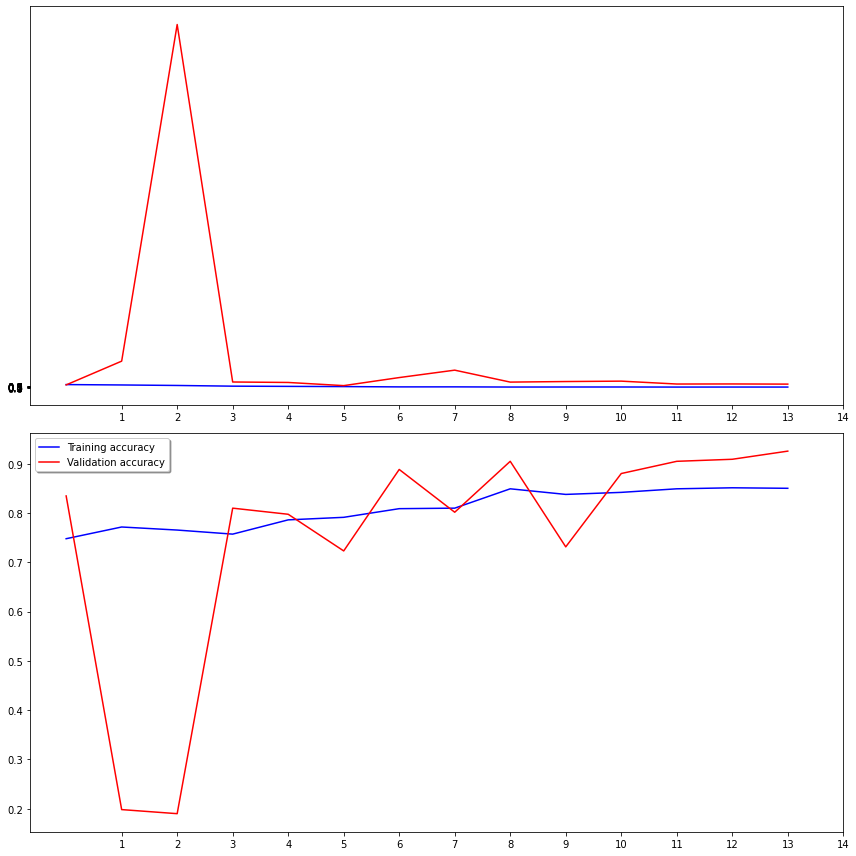

In [46]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 12))
ax1.plot(history.history['loss'], color='b', label="Training loss")
ax1.plot(history.history['val_loss'], color='r', label="validation loss")
ax1.set_xticks(np.arange(1, 15, 1))
ax1.set_yticks(np.arange(0, 1, 0.1))

ax2.plot(history.history['accuracy'], color='b', label="Training accuracy")
ax2.plot(history.history['val_accuracy'], color='r',label="Validation accuracy")
ax2.set_xticks(np.arange(1,15, 1))

legend = plt.legend(loc='best', shadow=True)
plt.tight_layout()
plt.show()

# Prepare Testing Data

In [77]:
test_filenames = os.listdir("C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test")
test_df = pd.DataFrame({
    'filename': test_filenames
})
nb_samples = test_df.shape[0]

In [78]:
test_df

,filename
0,DJI_20211222112118_0036_3072_5632.JPG
1,DJI_20211222115743_0008_512_6144.JPG
2,DJI_20211222115938_0013_2560_4096.JPG
3,DJI_20211222115939_0014_2560_4096.JPG
4,DJI_20220120134530_0312_1024_1024.JPG
5,DJI_20220120134530_0312_1024_1536.JPG
6,DJI_20220120134530_0312_1024_512.JPG
7,DJI_20220120134530_0312_1536_0.JPG
8,DJI_20220120134530_0312_3584_3072.JPG
9,DJI_20220120134530_0312_512_1536.JPG


In [79]:
nb_samples

15

# Create Testing Generator

In [80]:
test_gen = ImageDataGenerator(rescale=1./255)
test_generator = test_gen.flow_from_dataframe(
    test_df, 
    "C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test", 
    x_col='filename',
    y_col=None,
    class_mode=None,
    target_size=IMAGE_SIZE,
    batch_size=batch_size,
    shuffle=False
)

Found 15 validated image filenames.


# Predict

In [81]:
predict = model.predict_generator(test_generator, steps=np.ceil(nb_samples/batch_size))

For categoral classication the prediction will come with probability of each category. So we will pick the category that have the highest probability with numpy average max

In [82]:
test_df['category'] = np.argmax(predict, axis=-1)

We will convert the predict category back into our generator classes by using `train_generator.class_indices`. It is the classes that image generator map while converting data into computer vision

In [83]:
label_map = dict((v,k) for k,v in train_generator.class_indices.items())
test_df['category'] = test_df['category'].replace(label_map)

In [84]:
test_df

,filename,category
0,DJI_20211222112118_0036_3072_5632.JPG,cement
1,DJI_20211222115743_0008_512_6144.JPG,cement
2,DJI_20211222115938_0013_2560_4096.JPG,cement
3,DJI_20211222115939_0014_2560_4096.JPG,cement
4,DJI_20220120134530_0312_1024_1024.JPG,nocement
5,DJI_20220120134530_0312_1024_1536.JPG,nocement
6,DJI_20220120134530_0312_1024_512.JPG,nocement
7,DJI_20220120134530_0312_1536_0.JPG,nocement
8,DJI_20220120134530_0312_3584_3072.JPG,nocement
9,DJI_20220120134530_0312_512_1536.JPG,nocement


In [85]:
#test_df['category'] = test_df['category'].replace({ 'cement': 1, 'no_cement': 0 })

### Virtaulize Result

<AxesSubplot:>

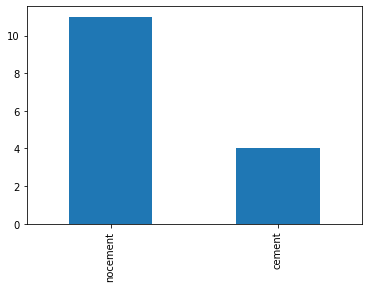

In [86]:
test_df['category'].value_counts().plot.bar()

### See predicted result with images

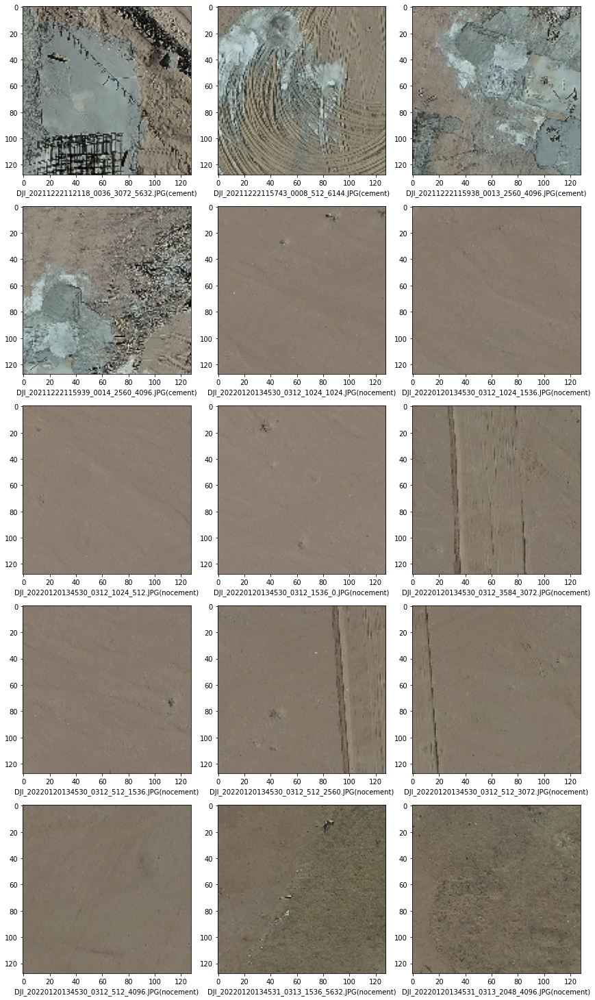

In [87]:
sample_test = test_df
sample_test.head()
plt.figure(figsize=(12, 24))
for index, row in sample_test.iterrows():
    filename = row['filename']
    category = row['category']
    img = load_img("C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test\\"+filename, target_size=IMAGE_SIZE)
    plt.subplot(6, 3, index+1)
    plt.imshow(img)
    plt.xlabel(filename + '(' + "{}".format(category) + ')' )
plt.tight_layout()
plt.show()

# Submission

In [88]:
submission_df = test_df.copy()
submission_df['id'] = submission_df['filename'].str.split('.').str[0]
submission_df['label'] = submission_df['category']
submission_df.drop(['filename', 'category'], axis=1, inplace=True)
submission_df.to_csv('submission.csv', index=False)

# Using full image

In [89]:
from PIL import Image
from itertools import product
import os

def tile(filename, dir_in, dir_out, d):
    """Source: https://stackoverflow.com/a/65698752/7677793"""
    name, ext = os.path.splitext(filename)
    img = Image.open(os.path.join(dir_in, filename))
    w, h = img.size
    
    grid = product(range(0, h-h%d, d), range(0, w-w%d, d))
    for i, j in grid:
        box = (j, i, j+d, i+d)
        out = os.path.join(dir_out, f'{name}_{i}_{j}{ext}')
        img.crop(box).save(out)

In [95]:
os.listdir('test full image')

['DJI_20220120114629_0321.JPG']

In [96]:
filename= os.listdir('test full image')[0]
dir_in= 'C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test full image'
dir_out="C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test patches"
d = 512

In [97]:
tile(filename, dir_in,dir_out,d)

### finding cement patches

In [98]:
test_filenames = os.listdir("test patches")
test_df = pd.DataFrame({
    'filename': test_filenames
})
nb_samples = test_df.shape[0]

In [99]:
test_df

,filename
0,DJI_20220120114629_0321_0_0.JPG
1,DJI_20220120114629_0321_0_1024.JPG
2,DJI_20220120114629_0321_0_1536.JPG
3,DJI_20220120114629_0321_0_2048.JPG
4,DJI_20220120114629_0321_0_2560.JPG
...,...
155,DJI_20220120114629_0321_512_5632.JPG
156,DJI_20220120114629_0321_512_6144.JPG
157,DJI_20220120114629_0321_512_6656.JPG
158,DJI_20220120114629_0321_512_7168.JPG


In [100]:
nb_samples

160

In [103]:
test_gen = ImageDataGenerator(rescale=1./255)
test_generator = test_gen.flow_from_dataframe(
    test_df, 
    "C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test patches", 
    x_col='filename',
    y_col=None,
    class_mode=None,
    target_size=IMAGE_SIZE,
    batch_size=batch_size,
    shuffle=False
)

Found 160 validated image filenames.


In [104]:
predict = model.predict_generator(test_generator, steps=np.ceil(nb_samples/batch_size))

In [105]:
test_df['category'] = np.argmax(predict, axis=-1)

In [106]:
label_map = dict((v,k) for k,v in train_generator.class_indices.items())
test_df['category'] = test_df['category'].replace(label_map)

In [107]:
test_df

,filename,category
0,DJI_20220120114629_0321_0_0.JPG,nocement
1,DJI_20220120114629_0321_0_1024.JPG,nocement
2,DJI_20220120114629_0321_0_1536.JPG,nocement
3,DJI_20220120114629_0321_0_2048.JPG,nocement
4,DJI_20220120114629_0321_0_2560.JPG,nocement
...,...,...
155,DJI_20220120114629_0321_512_5632.JPG,cement
156,DJI_20220120114629_0321_512_6144.JPG,cement
157,DJI_20220120114629_0321_512_6656.JPG,cement
158,DJI_20220120114629_0321_512_7168.JPG,nocement


<AxesSubplot:>

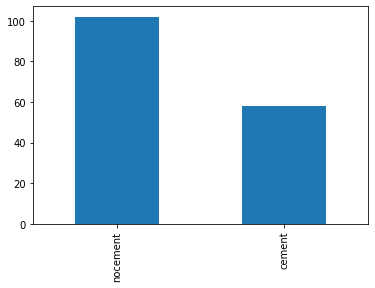

In [108]:
test_df['category'].value_counts().plot.bar()

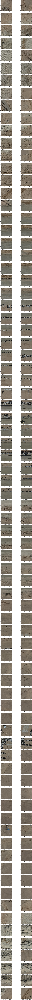

In [115]:
sample_test = test_df
sample_test.head()
plt.figure(figsize=(20, 400))
for index, row in sample_test.iterrows():
    filename = row['filename']
    category = row['category']
    img = load_img("C:\\Users\\Z004ET6Z\\OneDrive - Siemens AG\\Desktop\\total\\total\\test patches\\"+filename, target_size=IMAGE_SIZE)
    plt.subplot(80, 2, index+1)
    plt.imshow(img)
    plt.xlabel(filename + '(' + "{}".format(category) + ')' )
plt.tight_layout()
plt.show()

In [117]:
# submission_df = test_df.copy()
# submission_df['id'] = submission_df['filename'].str.split('.').str[0]
# submission_df['label'] = submission_df['category']
# submission_df.drop(['filename', 'category'], axis=1, inplace=True)
# submission_df.to_csv('submission_patch1.csv', index=False)